In [1]:
import sys

In [ ]:
cd '/srv/flash1/hagrawal9/project/habitat/habitat-api/'

In [ ]:
import io
import base64
import imageio
import gzip
import json
import json_tricks
import os
import sys
from typing import Any, Dict, List, Optional, Type

import attr
import cv2
import git
import magnum as mn
import numpy as np

# %matplotlib inline
from matplotlib import pyplot as plt
from pathlib import Path
from PIL import Image


import habitat
import habitat_sim

from rearrangement.task.sensors import *

from habitat.config import Config
from habitat.core.registry import registry
from habitat_sim.utils import viz_utils as vut
from habitat.utils.visualizations import maps
from habitat.utils.visualizations.utils import observations_to_image, paste_overlapping_image

from habitat_sim.physics import MotionType
from habitat_sim.utils.viz_utils import is_notebook, display_video, get_fast_video_writer

In [ ]:
from habitat.datasets.rearrangement.rearrangement_dataset import RearrangementDatasetV0
from habitat.tasks.rearrangement.rearrangement_task import RearrangementEpisode

In [ ]:
import pandas as pd

In [ ]:
# p = 'data/new_checkpoints/b9KSrZfBpB5WC5gcCUtmMX/replays/oracle_next_object/YTJsU6LqEcPLkfzhXxeZVJ'

p = 'data/new_checkpoints/b9KSrZfBpB5WC5gcCUtmMX/replays/map_object/WWBTQggtmP6xhX6uZRDitE/'

# data/new_checkpoints/b9KSrZfBpB5WC5gcCUtmMX/videos/map_object/dPKBtXvPV6S2RyA8HVckGZ
files = os.listdir(p)
j = 0

In [ ]:
file = 'replays_WWBTQggtmP6xhX6uZRDitE_76_Sands.glb.json'

In [ ]:
for i, file in enumerate(files[j:]):
    file = 'replays_WWBTQggtmP6xhX6uZRDitE_76_Sands.glb.json'
    with open(os.path.join(p, file), 'r') as f:
        data = json_tricks.load(f)
        print(data['info'])
        if data['episode_id'] == '76' and 'Sands' in data['scene_id']:
            print(data['info']['episode_success'])
    break
        

In [ ]:
print(i, file)

In [ ]:
eid = data['episode_id']
scene_id = data['scene_id']

In [ ]:
data['info']['episode_success'], data['episode_id']

In [ ]:
config = habitat.get_config("configs/tasks/rearrangement_gibson_map.yaml")

In [13]:
scene_id

'data/scene_datasets/gibson_train_val/Sands.glb'

In [14]:
config.defrost()
config.DATASET.SPLIT = "test"
config.DATASET.CONTENT_SCENES = [f"rearrangement_hard_v8_{config.DATASET.SPLIT}_n=100_o=5_t=0.9_{scene_id.split('/')[-1].split('.')[0]}"]
config.TASK.MEASUREMENTS = ['OBJECT_TO_GOAL_DISTANCE', 'AGENT_TO_OBJECT_DISTANCE', 'EOR_TOP_DOWN_MAP']
config.freeze()

In [15]:
import math

In [16]:
config.defrost()
config.SIMULATOR.ORTHOGRAPHIC_SENSOR.POSITION = [0.0, 5.0,  -0.0]
config.SIMULATOR.ORTHOGRAPHIC_SENSOR.ORIENTATION = [-0.708, 0, 0]
config.SIMULATOR.ORTHOGRAPHIC_SENSOR.HFOV = 180
config.freeze()

In [17]:
# config.defrost()
# config.SIMULATOR.DEPTH_SENSOR.HEIGHT = 1024
# config.SIMULATOR.DEPTH_SENSOR.WIDTH = 1024
# config.SIMULATOR.RGB_SENSOR.HEIGHT = 1024
# config.SIMULATOR.RGB_SENSOR.WIDTH = 1024
# config.SIMULATOR.CROSSHAIR_POS = [512, 768]
# config.TASK.EOR_TOP_DOWN_MAP.MAX_RESOLUTION = 1024
# config.freeze()

In [18]:
def print_info(obs, metrics):
    print(
        "Gripped Object: {}, Distance To Object: {}, Distance To Goal: {}".format(
            obs["gripped_object_id"],
            metrics["agent_to_object_distance"],
            metrics["object_to_goal_distance"],
        )
    )

In [19]:
try:
    env.close()
except:
    pass
env = habitat.Env(config)

2021-02-26 12:55:58,560 Initializing dataset RearrangementDataset-v0
2021-02-26 12:55:58,585 initializing sim RearrangementSim-v0


Episode Length: 0
Episode Length: 100


I0226 12:56:10.389384 17472 simulator.py:168] Loaded navmesh data/scene_datasets/gibson_train_val/Sands.navmesh
I0226 12:56:10.391855 17472 simulator.py:180] Recomputing navmesh for agent's height 0.88 and radius 0.18.
2021-02-26 12:56:10,506 Initializing task RearrangementTask-v0


In [20]:
import quaternion

In [21]:
for ep in env.episodes:
    if ep.episode_id == eid:
        break

In [22]:
env._current_episode = ep

In [23]:
env._current_episode.episode_id, env._current_episode.start_position

('76', [1.6729410886764526, 1.5990136861801147, -1.201284408569336])

In [24]:
episode_on_first_floor = []
for episode in env.episodes:
    # print(episode.episode_id)
    # print(episode.start_position[1])
    if episode.start_position[1] > 0:
        episode_on_first_floor.append(episode)

In [25]:
eid = '76'
for ep in env.episodes:
    if ep.episode_id == eid:
        print(ep.episode_id)
        env._current_episode = ep
        break
    

76


In [26]:
env._current_episode

RearrangementEpisode(episode_id='76', scene_id='data/scene_datasets/gibson_train_val/Sands.glb', start_position=[1.6729410886764526, 1.5990136861801147, -1.201284408569336], start_rotation=[0.0, 0.0, 0.0, 1.0], info={}, _shortest_path_cache=None, start_room=None, shortest_paths=None, objects=[RearrangementObjectSpec(bbox=None, position=[-0.8373242616653442, 1.6218512058258057, 2.645101547241211], rotation=[-0.4999999701976776, 0.4999999701976776, 0.4999999701976776, 0.4999999701976776], scale=[1.0, 1.0, 1.0], object_id=0, object_handle='data/ycb/012_strawberry.phys_properties.json'), RearrangementObjectSpec(bbox=None, position=[2.8659698963165283, 1.6322916746139526, -1.7723231315612793], rotation=[-0.4999999701976776, 0.4999999701976776, 0.4999999701976776, 0.4999999701976776], scale=[1.0, 1.0, 1.0], object_id=1, object_handle='data/ycb/065-c_cups.phys_properties.json'), RearrangementObjectSpec(bbox=None, position=[0.7959446310997009, 1.6268006563186646, 2.2599499225616455], rotation=

In [27]:
env._reset_stats()

if env._current_episode is not None:
    env._current_episode._shortest_path_cache = None
env.reconfigure(env._config)
obs = env.task.reset(episode=env._current_episode)
env._task.measurements.reset_measures(
    episode=env.current_episode, task=env.task
)
metrics = env.get_metrics()

Resetting Simulator!! 


In [28]:
env._sim._prev_sim_obs['gripped_object_id']

-1

In [29]:
current_state = env._sim.get_agent_state()

In [30]:
env._sim.get_agent_state().position, env._sim.get_agent_state().rotation

(array([ 1.6729411,  1.5990137, -1.2012844], dtype=float32),
 quaternion(1, 0, 0, 0))

In [31]:
current_state.position, current_state.rotation

(array([ 1.6729411,  1.5990137, -1.2012844], dtype=float32),
 quaternion(1, 0, 0, 0))

In [32]:
env._sim._sensors['rgb_orthographic']._sensor_object.reset_zoom()
env._sim._sensors['rgb_orthographic']._sensor_object.zoom(1.0)

In [33]:
# mn.Deg(env._sim._sensors['rgb_orthographic']._sensor_object.fov)
env._sim._sensors['rgb_orthographic']._sensor_object.near_plane_dist = 0.0
env._sim._sensors['rgb_orthographic']._sensor_object.far_plane_dist = 1000.0

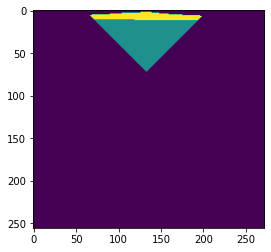

In [34]:
plt.imshow(env._task.sensor_suite.sensors['map_object'].visible_mask)

In [35]:
print(env._sim.get_agent_state().rotation)
egocentric_observations = []
obs_at = env._sim.get_observations_at(
    # [4.9221971355378628, 1.59, -3.02411952614784], 
    [ 2.6729411,  1.5990137, -1.2012844],
     quaternion.quaternion(0.500000059604645, 0, 0.866025388240814, 0)
)
egocentric_observations.append(obs_at)

quaternion(1, 0, 0, 0)


In [36]:
def get_polar_angle(env):
    agent_state = env._sim.get_agent_state()
    # quaternion is in x, y, z, w format
    ref_rotation = agent_state.rotation

    heading_vector = quaternion_rotate_vector(
        ref_rotation.inverse(), np.array([0, 0, -1])
    )

    phi = cartesian_to_polar(-heading_vector[2], heading_vector[0])[1]
    z_neg_z_flip = np.pi
    return np.array(phi) + z_neg_z_flip

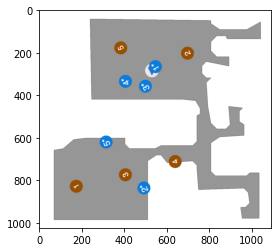

In [37]:
top_down_map = maps.get_topdown_map(
    env._task._simple_pathfinder,
    env._sim.get_agent(0).state.position[1],
    1024
)

top_down_map = maps.colorize_topdown_map(top_down_map)
agent_position = env._sim.get_agent_state().position
a_x, a_y = maps.to_grid(
    agent_position[2],
    agent_position[0],
    top_down_map.shape[0:2],
    sim=env._sim,
)

episode = env.current_episode
object_positions = [obj.position for obj in episode.objects]
goal_positions = [obj.position for obj in episode.goals]

grid_object_positions = []
grid_goal_positions = []

for i, obj_pos in enumerate(object_positions):
    tdm_pos = maps.to_grid(
        obj_pos[2],
        obj_pos[0],
        top_down_map.shape[0:2],
        sim=env._sim,
    )
    grid_object_positions.append(tdm_pos)

# draw the objectgoal positions.
for i, goal_pos in enumerate(goal_positions):
    tdm_pos = maps.to_grid(
        goal_pos[2],
        goal_pos[0],
        top_down_map.shape[0:2],
        sim=env._sim,
    )

    grid_goal_positions.append(tdm_pos)
    
grid_current_positions = [None] * len(object_positions)
for sim_obj_id in env._sim.get_existing_object_ids():
    if sim_obj_id != env._task.agent_object_id:
        obj_id = env._task.sim_object_to_objid_mapping[sim_obj_id]
        position = env._sim.get_translation(sim_obj_id)
        curr_pos = maps.to_grid(position[2], position[0], top_down_map.shape[0:2], sim=env._sim)
        grid_current_positions[obj_id] = curr_pos

    
top_down_map = maps.draw_agent(
    image=top_down_map,
    agent_center_coord=[a_x, a_y],
    agent_rotation=0,
    agent_radius_px=min(top_down_map.shape[0:2]) / 32,
)

top_down_map = maps.draw_object_info(top_down_map, grid_goal_positions, suffix='g')
top_down_map = maps.draw_object_info(top_down_map, grid_current_positions, suffix='c')

plt.imshow(top_down_map)
# plt.savefig('top_down_map_illustration.png')

In [38]:
grid_resolution = (256, 256)
lower_bound, upper_bound = env._sim.pathfinder.get_bounds()
grid_size = (
    abs(upper_bound[2] - lower_bound[2]) / grid_resolution[0],
    abs(upper_bound[0] - lower_bound[0]) / grid_resolution[1],
)
resolution = min(grid_size)

text = f"{resolution * 269.07:.2f} m"

In [39]:
print(text)

7.60 m


In [40]:
def compute_distances_on_map(tdmap, p1, p2, sim):
    p1 = maps.to_grid(
        p1[2],
        p1[0],
        tdmap.shape[0:2],
        sim=sim,
    )
    
    p2 = maps.to_grid(
        p2[2],
        p2[0],
        tdmap.shape[0:2],
        sim=sim,
    )
    
    dmap = compute_distance_using_fmm(tdmap, p1)
    dist = find_dist_from_map(dmap, p2)
    return dist
    
def draw_distances(env, map_image, plan):
    
    dmat, agent_dmap = compute_distance_mat_using_fmm(env._task.sensor_suite.sensors['map_object'].obstacles_mask, [a_y, a_x], grid_current_positions, grid_goal_positions)
    
    current_pos = [a_y, a_x]
    for obj_id in plan: 
        obj_id = obj_id -1 
        next_pos = grid_current_positions[obj_id][::-1]
        cv2.line(map_image, tuple(current_pos), tuple(next_pos), (0, 255, 0), thickness=2)
        
        mid_point = (np.array(next_pos) + np.array(current_pos))/2 + [10, 10]
        
        
        cv2.putText(
            map_image,
            text=f"{dmat[0, obj_id + 1]*4:.2f}",
            org=tuple(mid_point.astype('long')),
            fontFace=cv2.FONT_HERSHEY_SIMPLEX,
            fontScale=2,
            color=(255, 255, 255),
            thickness=3,
            lineType=cv2.LINE_AA,
        )
        
        current_pos = next_pos
        next_pos = grid_goal_positions[obj_id][::-1]
        cv2.line(map_image, tuple(current_pos), tuple(next_pos), (255, 0, 0), thickness=2)
        
        mid_point = (np.array(next_pos) + np.array(current_pos))/2 + [10, 10]
        # print(mid_point, next_pos, current_pos)
        cv2.putText(
            map_image,
            text=f"{dmat[obj_id + 1, obj_id + 1 + 5]*4:.2f}",
            org=tuple(mid_point.astype('long')),
            fontFace=cv2.FONT_HERSHEY_SIMPLEX,
            fontScale=2,
            color=(255, 255, 255),
            thickness=2,
            lineType=cv2.LINE_AA,
        )
        
        current_pos = next_pos
        break
    
def draw_agent_and_objects(env, map_image, plan):
    top_down_map = maps.get_topdown_map(
        env._task._simple_pathfinder,
        env._sim.get_agent(0).state.position[1],
        1024
    )

    top_down_map = maps.colorize_topdown_map(top_down_map)
    agent_position = env._sim.get_agent_state().position
    a_x, a_y = maps.to_grid(
        agent_position[2],
        agent_position[0],
        top_down_map.shape[0:2],
        sim=env._sim,
    )

    episode = env.current_episode
    object_positions = [obj.position for obj in episode.objects]
    goal_positions = [obj.position for obj in episode.goals]

    grid_object_positions = []
    grid_goal_positions = []

    for i, obj_pos in enumerate(object_positions):
        tdm_pos = maps.to_grid(
            obj_pos[2],
            obj_pos[0],
            top_down_map.shape[0:2],
            sim=env._sim,
        )
        grid_object_positions.append(tdm_pos)

    # draw the objectgoal positions.
    for i, goal_pos in enumerate(goal_positions):
        tdm_pos = maps.to_grid(
            goal_pos[2],
            goal_pos[0],
            top_down_map.shape[0:2],
            sim=env._sim,
        )

        grid_goal_positions.append(tdm_pos)

    grid_current_positions = [None] * len(object_positions)
    for sim_obj_id in env._sim.get_existing_object_ids():
        if sim_obj_id != env._task.agent_object_id:
            obj_id = env._task.sim_object_to_objid_mapping[sim_obj_id]
            position = env._sim.get_translation(sim_obj_id)
            curr_pos = maps.to_grid(position[2], position[0], top_down_map.shape[0:2], sim=env._sim)
            grid_current_positions[obj_id] = curr_pos

    agent_sprite = np.ones((25, 25, 3))* 1
    

    map_image = maps.draw_object_info(map_image, grid_goal_positions, suffix='g')
    map_image = maps.draw_object_info(map_image, grid_current_positions, suffix='c')
    
    map_image = maps.draw_agent(
        image=map_image,
        agent_center_coord=[a_x, a_y],
        agent_rotation=get_polar_angle(env),
        agent_radius_px=min(top_down_map.shape[0:2]) / 32,
    )
    
    # dmat = env._task.misc_dict['dmat']
    
    # dmat, agent_dmap = compute_distance_mat_using_fmm(env._task.sensor_suite.sensors['map_object'].obstacles_mask, [a_y, a_x], grid_current_positions, grid_goal_positions)
    # dmat, agent_dmap = compute_distance_mat_using_fmm(env._task.sensor_suite.sensors['map_object'].obstacles_mask, [a_y, a_x], grid_current_positions, grid_goal_positions)

    current_pos = [a_y, a_x]
    
    grid_resolution = (256, 256)
    lower_bound, upper_bound = env._sim.pathfinder.get_bounds()
    grid_size = (
        abs(upper_bound[2] - lower_bound[2]) / grid_resolution[0],
        abs(upper_bound[0] - lower_bound[0]) / grid_resolution[1],
    )
    resolution = min(grid_size)

    
    for obj_id in plan: 
        obj_id = obj_id -1 
        next_pos = grid_current_positions[obj_id][::-1]
        cv2.line(map_image, tuple(current_pos), tuple(next_pos), (0, 255, 0), thickness=2)
        
        mid_point = (np.array(next_pos) + np.array(current_pos))/2 + [10, 10]
        
        sim_obj_id = env._task.objid_to_sim_object_mapping[obj_id]
        object_position = env._sim.get_translation(sim_obj_id)
        goal_position = goal_positions[obj_id]
        dist = compute_distances_on_map(env._task.sensor_suite.sensors['map_object'].obstacles_mask, agent_position, object_position, env._sim)
        if dist >= 10: 
            cv2.putText(
                map_image,
                text=f"{dist * resolution:.2f} m",
                org=tuple(mid_point.astype('long')),
                fontFace=cv2.FONT_HERSHEY_SIMPLEX,
                fontScale=2,
                color=(255, 255, 255),
                thickness=3,
                lineType=cv2.LINE_AA,
            )
        
        # current_pos = next_pos
        next_pos = grid_goal_positions[obj_id][::-1]
        cv2.line(map_image, tuple(current_pos), tuple(next_pos), (255, 0, 0), thickness=2)
        
        mid_point = (np.array(current_pos) + np.array(next_pos))/2 + [10, 10]
        
        dist = compute_distances_on_map(env._task.sensor_suite.sensors['map_object'].obstacles_mask, agent_position, goal_position, env._sim)
        #. print(dist)
        # print(mid_point, next_pos, current_pos)
        cv2.putText(
            map_image,
            text=f"{dist * resolution:.2f} m",
            org=tuple(mid_point.astype('long')),
            fontFace=cv2.FONT_HERSHEY_SIMPLEX,
            fontScale=2,
            color=(255, 255, 255),
            thickness=2,
            lineType=cv2.LINE_AA,
        )
        
        current_pos = next_pos
        break
    
    cv2.putText(
        map_image,
        text=f"Distance w.r.t agent",
        org=(180, 980),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=2,
        color=(255, 255, 255),
        thickness=2,
        lineType=cv2.LINE_AA,
    )

    return map_image

In [41]:
env._task.objid_to_sim_object_mapping

{0: 1, 1: 2, 2: 3, 3: 4, 4: 5}

In [42]:
env._task.misc_dict['route_idxs']

[0, 5, 10, 1, 6, 2, 7, 3, 8, 4, 9]

In [43]:
import copy
import PIL
from io import StringIO, BytesIO

230.82088477133078
[248 230  33]


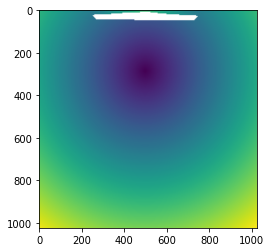

In [44]:
explored_map = copy.deepcopy(env._task.misc_dict['agent_dmap'])
if len(explored_map.shape) == 2:
    max_value = np.max(explored_map[explored_map!=np.inf])
    print(max_value)
    inf_indices = np.where(explored_map == np.inf)
    explored_map[explored_map == np.inf] = max_value + 1
    
    indices = np.where(explored_map == max_value)
    
    y_x = (indices[0][0], indices[1][0])
    
    explored_map = (explored_map / np.max(explored_map)) * 255.0
    explored_map = cv2.applyColorMap(explored_map.astype('uint8'), cv2.COLORMAP_VIRIDIS)
    explored_map = cv2.cvtColor(explored_map, cv2.COLOR_BGR2RGB)
    explored_map[inf_indices[0], inf_indices[1], :] = 255
    print(explored_map[y_x[0], y_x[1]])
    explored_map = cv2.resize(explored_map, (1024, 1024), interpolation = cv2.INTER_AREA)
    

# plt.imshow(draw_agent_and_objects(env, explored_map, plan=[2,1,3,4,5]))
plt.imshow(explored_map)
plt.show()


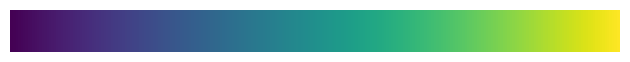

In [45]:
gradient = np.linspace(0, 1, 256)
gradient = np.vstack((gradient, gradient))


def plot_color_gradients(cmap_category, name):
    # Create figure and adjust figure height to number of colormaps
    figh = 0.35 + 0.15 + 0.22
    fig = plt.figure(figsize=(6.4, figh), dpi=100)
    # plt.title(cmap_category + ' colormaps', fontsize=14)

    plt.imshow(gradient, aspect='auto', cmap=plt.get_cmap(name))
    # plt.text(-.01, .5, name, va='center', ha='right', fontsize=10)
    plt.tick_params(
        axis='both',          # changes apply to the x-axis
        which='both',      # both major and minor ticks are affected
        bottom=False,      # ticks along the bottom edge are off
        top=False,         # ticks along the top edge are off
        labelbottom=False) # labels along the bottom edge are off

    plt.axis('off')
    
plot_color_gradients('Perceptually Uniform Sequential', 'viridis')

buffer_ = BytesIO()
plt.tight_layout()
plt.margins(0,0)

plt.savefig(buffer_, format = "png", pad_inches = 0, bbox_layout="tight")
plt.gca().xaxis.set_major_locator(plt.NullLocator())
plt.gca().yaxis.set_major_locator(plt.NullLocator())
buffer_.seek(0)
image = PIL.Image.open(buffer_)
ar = np.asarray(image)
buffer_.close()

In [46]:
color_bar_ar = np.transpose(ar, (1,0, 2))

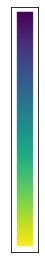

In [47]:
plt.imshow(color_bar_ar)
plt.tight_layout()
plt.margins(0,0)
plt.gca().xaxis.set_major_locator(plt.NullLocator())
plt.gca().yaxis.set_major_locator(plt.NullLocator())
plt.show()

In [48]:
grid_resolution = (256, 256)
lower_bound, upper_bound = env._sim.pathfinder.get_bounds()
grid_size = (
    abs(upper_bound[2] - lower_bound[2]) / grid_resolution[0],
    abs(upper_bound[0] - lower_bound[0]) / grid_resolution[1],
)
resolution = min(grid_size)

In [49]:
max_value = np.max(explored_map[explored_map!=np.inf])

text = f"{max_value * resolution:.2f} m"
print(text)

7.20 m


In [50]:
def restore_state(replay, env):
    for sim_obj_id, obj_id in replay['sim_object_id_to_objid_mapping'].items(): 
        curr_sim_obj_id = env._task.objid_to_sim_object_mapping[obj_id]
        env._sim.set_object_motion_type(
            MotionType.KINEMATIC, curr_sim_obj_id
        )
        env._sim.set_translation(replay['current_position'][sim_obj_id], curr_sim_obj_id)
        env._sim.set_object_motion_type(
            MotionType.STATIC, curr_sim_obj_id
        )
        agent_cfg = env._sim._get_agent_config(0)
        env._sim.set_agent_state(
            replay['agent_pos'],
            agent_cfg.START_ROTATION,
            0,
        )
        env._sim.set_translation(replay['agent_pos'], env._task.agent_object_id)
        

        print(sim_obj_id, obj_id, curr_sim_obj_id)
    env._task.measurements.update_measures(
        episode=env.current_episode, action=0, task=env.task
    )

In [51]:
def draw_text(
    step,
    img,
    text,
    uv_top_left,
    color=(255, 255, 255),
    fontScale=2,
    thickness=4,
    fontFace=cv2.FONT_HERSHEY_SIMPLEX,
    line_spacing=1.5
):
    """
    Draws multiline with an outline.
    """
    assert isinstance(text, str)

    uv_top_left = np.array(uv_top_left, dtype=float)
    assert uv_top_left.shape == (2,)

    for j, line in enumerate(text.splitlines()):
        (w, h), _ = cv2.getTextSize(
            text=line,
            fontFace=fontFace,
            fontScale=fontScale,
            thickness=thickness,
        )
        uv_bottom_left_i = uv_top_left + [0, h]

        for i, s in enumerate(line.split('* ')):
            if j < 0 and step % 5 == 0:   # <0 to disable
                c = (0, 0, 255)
            else:
                c = color[i]

            org = tuple(uv_bottom_left_i.astype(int))
            cv2.putText(
                img,
                text=s,
                org=org,
                fontFace=fontFace,
                fontScale=fontScale,
                color=c,
                thickness=thickness,
                lineType=cv2.LINE_AA,
            )
            
            (w, h), _ = cv2.getTextSize(
                text=s,
                fontFace=fontFace,
                fontScale=fontScale,
                thickness=thickness,
            )

            uv_bottom_left_i = uv_bottom_left_i + [w, 0]

        uv_top_left += [0, h * line_spacing]

In [52]:
def depth_to_rgb(depth_image: np.ndarray, clip_max: float = 10.0) -> np.ndarray:
    """Normalize depth image into [0, 1] and convert to grayscale rgb
    :param depth_image: Raw depth observation image from sensor output.
    :param clip_max: Max depth distance for clipping and normalization.
    :return: Clipped grayscale depth image data.
    """
    d_im = np.clip(depth_image, 0, clip_max)
    d_im /= clip_max
    # d_im = np.stack([d_im for _ in range(3)], axis=2)
    rgb_d_im = (d_im * 255).astype(np.uint8)
    return rgb_d_im

In [53]:
def render_frame(obs, info, obs_ortho, explored_map, step, int_step=0, reset_plan=False):
    img_frame = Image.fromarray(obs['rgb_3rd_person'])
    rgb = Image.fromarray(obs['rgb'])
    
    if "depth" in obs:
        d_im = depth_to_rgb(obs['depth'], clip_max=1.0)[:, :, 0]
        depth_map = np.stack([d_im for _ in range(3)], axis=2)

        depth = Image.fromarray(
            depth_map
        )


    overlay_rgb_img = rgb.resize((256, 256))
    overlay_depth_img = depth.resize((256, 256))

    img_frame.paste(overlay_rgb_img, box=(32, 32))
    img_frame.paste(overlay_depth_img, box=(32, 320))
    img_frame = np.array(img_frame)
    
    draw_text(step, img_frame, "step = {}".format(step), (1500, 10), fontScale=2.5, color=[(255, 255, 255), (125, 125, 125)]) 
    
    
    top_down_map = maps.colorize_draw_agent_and_fit_to_height(
            info["top_down_map"], img_frame.shape[0]
        )
    img_frame = np.concatenate((img_frame, obs_ortho), axis=1)
    zero_frame = np.zeros_like(img_frame)
    zero_frame[:top_down_map.shape[0], :top_down_map.shape[1], :] = top_down_map
    
    td_h, td_w = top_down_map.shape[:2]
    
    if len(explored_map.shape) == 2:
        max_value = np.max(explored_map[explored_map!=np.inf])
        inf_indices = np.where(explored_map == np.inf)
        explored_map[explored_map == np.inf] = max_value + 10
        explored_map = (explored_map / np.max(explored_map)) * 255.0
        explored_map = cv2.applyColorMap(explored_map.astype('uint8'), cv2.COLORMAP_VIRIDIS)
        explored_map[inf_indices[0], inf_indices[1], :] = 255
        explored_map = cv2.cvtColor(explored_map, cv2.COLOR_BGR2RGB)
        
        
    explored_map = cv2.resize(explored_map, (1024, 1024), interpolation = cv2.INTER_AREA)
    explored_map[192:832, 880:952, :] = color_bar_ar[:, :, :3]
    draw_text(step, explored_map, "0 m".format(step), (850, 120), fontScale=2.0, color=[(255, 255, 255), (125, 125, 125)]) 
    draw_text(step, explored_map, "7.2 m".format(step), (830, 850), fontScale=2.0, color=[(255, 255, 255), (125, 125, 125)]) 
    
    plan = [x.strip() for x in info['predicted_pickup_order'].split('*')[1].split(' ')]
    plan = [int(x) for x in plan[1:]]
    
    explored_map = draw_agent_and_objects(env, explored_map, plan)
    
    # explored_map = draw_agent_and_objects(env, explored_map)
    
    em_h, em_w = explored_map.shape[:2]
    
    zero_frame[0: em_h, em_w: em_w + em_w, :] = explored_map
    
    if not reset_plan: 
        text = """
PLASMA - Current Plan: 
{}

""".format(info['predicted_pickup_order'])
        int_step = 0
    else:
        text = """
PLASMA - Previous Plan: 
{}

PLASMA - Current Plan: 
{}
""".format(info['predicted_pickup_order'], info['predicted_pickup_order'])
        
    
    text2 = """
GT Pickup Order:
{}

Episode SPL: 
0.8577
    """.format(info['oracle_pickup_order'])
    
    # print(text)
    
    # Using cv2.putText() method 
    
    y_coordinate = 10 - int_step*20
    int_step += 1
        
    draw_text(step, zero_frame, text, (2048, y_coordinate), fontScale=2.5, color=[(255, 255, 255), (125, 125, 125)]) 
    draw_text(step, zero_frame, text2, (2048, 500), fontScale=2.5, color=[(255, 255, 255), (125, 125, 125)]) 
    
#     if step % 5 == 0: 
#         start_point = (2048, 10) 
#         end_point = (3072, 1014) 
#         color = (0, 0, 255) 
#         thickness = 20
#         zero_frame = cv2.rectangle(zero_frame, start_point, end_point, color, thickness) 

    img_frame = np.concatenate((img_frame, zero_frame), axis=0)
    
    if int_step >= 5:
        int_step = 0 
        
    return img_frame, int_step

In [54]:
data['info']['episode_spl']

0.8577103955878674

In [55]:
orthographic_observations = []

In [56]:
orthographic_observations = np.load('data/orthographic_replays_WWBTQggtmP6xhX6uZRDitE_76_Sands.npy')

In [82]:
for i, action in enumerate(data['actions']):
#     if data['actions'][i + 3]['action'] == 3:
#         break
    obs = env.step(action['action'])
    obs_at = env._sim.get_observations_at(
        # [4.9221971355378628, 1.59, -3.02411952614784], 
        [ 2.6729411,  1.5990137, -1.2012844],
         quaternion.quaternion(0.500000059604645, 0, 0.866025388240814, 0)
    )
    
    orthographic_observations.append(obs_at['rgb_orthographic'])
    

AttributeError: 'numpy.ndarray' object has no attribute 'append'

In [ ]:
np.save('data/orthographic_replays_WWBTQggtmP6xhX6uZRDitE_76_Sands.npy', orthographic_observations)

In [57]:
predicted_pickup_order = [['*', '5', '1', '2', '3', '4']]* 60
predicted_pickup_order += [['*', '5', '4', '1', '2', '3']]* 10
predicted_pickup_order +=[['5', '*', '4', '1', '2', '3']]*85
predicted_pickup_order += [['5', '4', '*', '1', '2', '3']]*115
predicted_pickup_order += [['5', '4', '1', '*', '2', '3']]*65
predicted_pickup_order += [['5', '4', '1', '2', '*', '3']]*70

In [58]:
frames = []
metric_list = []
obs_list = []
constructed_map = []

unplaced_pickup_order = []

int_step = 0
for i, action in enumerate(data['actions'][:]):
    obs = env.step(action['action'])
    
    # explored_map = env._task.sensor_suite.sensors['map_object'].visible_mask
    pickup_order = env._task.sensor_suite.sensors['map_object'].pickup_order
    
    unplaced_pickup_order.append(pickup_order)
    
    explored_map = copy.deepcopy(env._task.misc_dict['agent_dmap'])
    metrics = env.get_metrics()
    metrics.update(
        {
            'oracle_pickup_order': ' '.join([str(k) for k in env._task.misc_dict['pickup_order_oracle_next_object'] + 1]), 
            'predicted_pickup_order': ' '.join([str(k) for k in predicted_pickup_order[i]])
        }
    )
    
    
    # print(metrics['oracle_pickup_order'], metrics['predicted_pickup_order'])
    if i % 20 < 5:
        reset_plan=True
    else:
        reset_plan = False
    
    img_frame, _ = render_frame(obs, metrics, orthographic_observations[i], explored_map, i, int_step, reset_plan)
    
    int_step += 1
    
    if int_step >=10: 
        int_step = 0
        
    frames.append(img_frame)
    obs_list.append(obs)
    # constructed_map.append(env._task.misc_dict['obstacles_mask'])
    metric_list.append(metrics)

    print(f"\r {i}, {len(data['actions'])}", end=" ")
    if action['action'] == 3:
        print("----")

#     plt.imshow(obs['rgb_3rd_person'])
#     plt.title(action)
#     plt.show()

 8, 402 ----
 72, 402 ----
 97, 402 ----
 156, 402 ----
 215, 402 ----
 274, 402 ----
 287, 402 ----
 339, 402 ----
 348, 402 ----
 401, 402 ----


In [59]:
writer = get_fast_video_writer('data/replays_WWBTQggtmP6xhX6uZRDitE_76_Sands.mp4', fps=10)

for image_frame in frames:
    writer.append_data(np.array(image_frame))

writer.close()

In [60]:
display_video('data/replays_WWBTQggtmP6xhX6uZRDitE_76_Sands.mp4')